<center> <span style="font-family:newtimeroman"> <span style="padding:300px;display:fill;border-radius:250px 250px;background-color:#D72A2B;font-size:200%;font-weight: 600;color:#F2ECC6;overflow:hidden;"> 5.3. Hierarchical Clusteringㅤ</span>

<div style="border-radius:15px;border:#B71C1B solid;background-color:#F2ECC6; padding:20px; font-size:15px">

### ✍️Hierarchical Clustering
    
**Hierarchical clustering** is a popular technique used in data analysis to group similar items together into clusters based on their similarity or dissimilarity. This method involves recursively splitting or merging clusters in a hierarchical fashion until all the items belong to a single cluster. Hierarchical clustering can be performed in two ways: 

- **Agglomerative**
- **Divisive**

**Agglomerative clustering** starts by treating each item as a separate cluster and then iteratively merges the closest pairs of clusters based on a similarity measure until all the items belong to a single cluster. 

In contrast, **divisive clustering** starts with all the items in a single cluster and recursively splits the clusters into smaller ones until each item forms its own cluster. 

#### 🌴Agglomerative Clustering

In [74]:
# Calculate silhouette coefficient and calinski harabasz coefficient
silhouette_coef = []
for n_clust in range(2,11):
    AgglomerativeC = AgglomerativeClustering(n_clusters=n_clust, affinity='euclidean', linkage='ward')
    labels = AgglomerativeC.fit_predict(scaled_col)
    score = silhouette_score(scaled_col, labels)
    silhouette_coef.append(score)

calinski_harabasz_coef = []
for n_clust in range(2,11):
    AgglomerativeC = AgglomerativeClustering(n_clusters=n_clust, affinity='euclidean', linkage='ward')
    AgglomerativeC.fit(scaled_col)
    score = metrics.calinski_harabasz_score(scaled_col, AgglomerativeC.labels_)
    calinski_harabasz_coef.append(score)

In [75]:
# Create a dataframe to store the scores
scores_AgglomerativeC = pd.DataFrame({'n_clust': range(2,11),
'Silhouette Score': silhouette_coef,
'Calinski-Harabasz Score': calinski_harabasz_coef})

# Find the best k for each score
best_k_silhouette = scores_AgglomerativeC.loc[scores_AgglomerativeC['Silhouette Score'].idxmax(), 'n_clust']
best_k_calinski_harabaz = scores_AgglomerativeC.loc[scores_AgglomerativeC['Calinski-Harabasz Score'].idxmax(), 'n_clust']

In [76]:
print("\nScores for Different Numbers of Clusters:")
scores_AgglomerativeC.style.background_gradient(cmap=cmap).set_properties(**{'font-family': 'Segoe UI'}).hide_index()


Scores for Different Numbers of Clusters:


n_clust,Silhouette Score,Calinski-Harabasz Score
2,0.175247,1418.186804
3,0.157469,1244.046287
4,0.155519,1254.069649
5,0.169326,1163.154162
6,0.171827,1112.023800
7,0.154345,1086.284846
8,0.145808,1051.585288
9,0.152725,1030.229803
10,0.157559,1017.485186


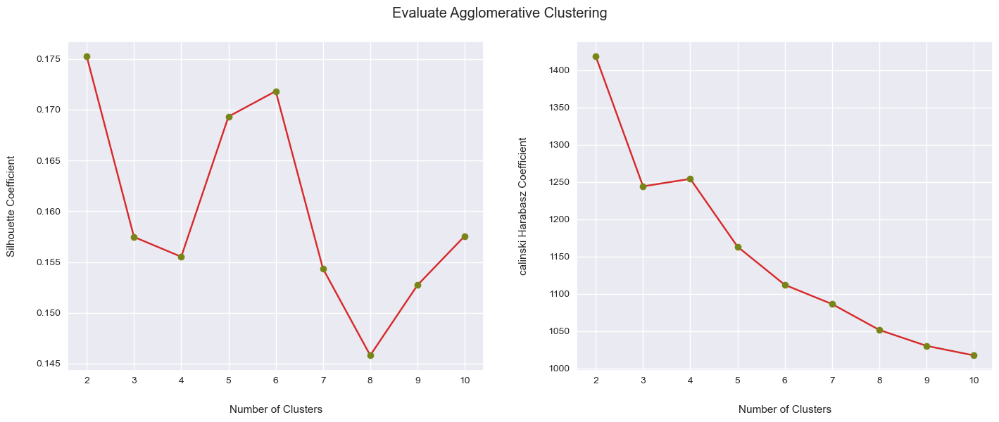

In [77]:
# Visualize plots of silhouette and calinski harabasz scores for kmeans models
plot_evaluation(silhouette_coef, calinski_harabasz_coef, 'Agglomerative')

#### 🌴Find the best 'k' for Silhouette and Calinski-Harabasz

In [78]:
# Best k for each coef
print(f"\n▪️Best k for Silhouette Coefficient: {best_k_silhouette}")
print(f"▪️Best k for Calinski-Harabasz Coefficient: {best_k_calinski_harabaz}")


▪️Best k for Silhouette Coefficient: 2
▪️Best k for Calinski-Harabasz Coefficient: 2


<div style="border-radius:15px;border:#B71C1B solid;background-color:#F2ECC6; padding:20px; font-size:15px">

**✍️Dendrograms**
    
**Dendrograms** are hierarchical diagrams used to represent the relationships between different entities or objects, such as genes, species, or individuals, based on their similarities or differences in certain characteristics or traits. In a dendrogram, each entity is represented by a leaf, and branches represent the clustering of these entities based on their similarities or differences. The height of each branch corresponds to the level of similarity or distance between the entities it connects. Dendrograms are commonly used in fields such as biology, ecology, and data analysis to visualize the relationships between different data points and to identify clusters or groups within datasets.

#### 🌴Dendrogram (Ward Linkage)

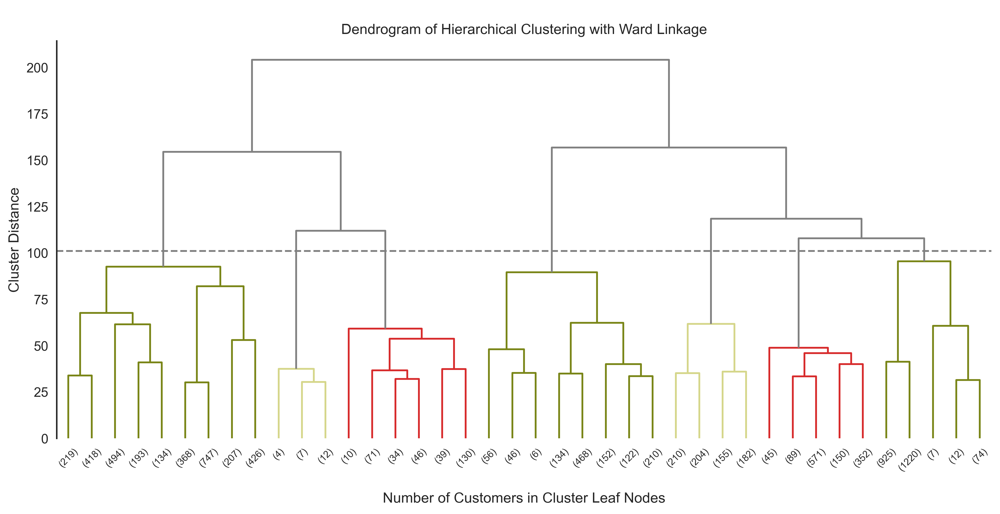

In [79]:
sns.set(rc={'figure.dpi':400})
sns.set_context('notebook')
sns.set_style('ticks')

Z = hierarchy.linkage(scaled_col, method='ward', metric='euclidean')
fig, ax = plt.subplots(figsize=(14,6))
hierarchy.set_link_color_palette(["#798517", "#D5D68A", "#D72A2B"])
den = hierarchy.dendrogram(Z, orientation='top', color_threshold=102, p=40, truncate_mode='lastp',
                           show_leaf_counts=True, ax=ax,
                           above_threshold_color='grey')
ax.axhline(101, color='grey', linestyle='--')
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.tick_params(axis=u'both', which=u'both', length=0)
ax.set_xlabel('\nNumber of Customers in Cluster Leaf Nodes')
ax.set_ylabel('Cluster Distance')
ax.set_title('\nDendrogram of Hierarchical Clustering with Ward Linkage')
fig.show()

#### 🌴Implement Agglomerative Clustering with the Best Number of Clusters

In [80]:
# Run Agglomerative clustering with n_clusters=2
hc = AgglomerativeClustering(n_clusters=2, affinity='euclidean', linkage='ward').fit(scaled_col)

# Get the cluster labels assigned to each data point by Agglomerative clustering
cluster_labels = hc.labels_

# Get the coordinates of the centroids of the two clusters
centroids = np.zeros((2, scaled_col.shape[1]))
for i in range(2):
    cluster_i = scaled_col[cluster_labels == i]
    centroids[i,:] = cluster_i.mean(axis=0)

# Convert the centroids array to a DataFrame and assign column names
centroids = pd.DataFrame(centroids, columns=scaled_col.columns)
centroids

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,0.054363,-0.254059,-0.323562,-0.243196,-0.318221,0.179684,-0.615850,-0.407432,-0.506664,0.229703,0.160950,-0.416882,-0.131236,-0.106167,0.042405,-0.216343,-0.198518
1,-0.082331,0.384766,0.490026,0.368313,0.481936,-0.272126,0.932687,0.617044,0.767327,-0.347879,-0.243753,0.631355,0.198753,0.160787,-0.064221,0.327645,0.300650


In [81]:
# Get the cluster labels assigned to each data point by Agglomerative clustering
pred = hc.labels_

# Convert the centroids from scaled values to the original scale
real_centroids = scaler.inverse_transform(centroids)

# Convert the centroids array to a DataFrame and assign column names
real_centroids = pd.DataFrame(real_centroids, columns=df.columns)
real_centroids

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,1677.802056,0.817193,311.990677,188.828234,123.337787,1355.782900,0.243242,0.080932,0.163115,0.181109,4.347495,4.34898,4016.93261,1425.981436,943.924698,0.090453,11.252505
1,1393.278512,0.968457,2050.310062,1203.857907,846.941486,408.271923,0.864727,0.386562,0.669436,0.065523,1.585558,30.40517,5217.63455,2198.816661,695.189921,0.249566,11.919921


#### 🌴Evaluation of the performance of the Agglomerative Clustering model

In [82]:
# Calculate scores
silhouette = silhouette_score(scaled_col, pred)
calinski = calinski_harabasz_score(scaled_col, pred)

# Create a DataFrame with the scores
Agglomerative_scores = pd.DataFrame({'Silhouette Score': [silhouette], 'Calinski-Harabasz Score': [calinski]}, index=['Agglomerative'])
Agglomerative_scores

,Silhouette Score,Calinski-Harabasz Score
Agglomerative,0.175247,1418.186804


#### 🌴Addition of Cluster Column to the Data frame

In [83]:
Agglomerative_clustered_df = pd.concat([df, pd.DataFrame(pred, columns=['Agglomerative Cluster'])], axis = 1)
Agglomerative_clustered_df.head(10).style.set_properties(**{'background-color': '#F2ECC6'}, subset=['Agglomerative Cluster'])

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,Agglomerative Cluster
0,40.900749,0.818182,95.400000,0.000000,95.400000,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.000000,201.802084,139.509787,0.000000,12,0
1,3202.467416,0.909091,0.000000,0.000000,0.000000,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.000000,4103.032597,1072.340217,0.222222,12,0
2,2495.148862,1.000000,773.170000,773.170000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.000000,622.066742,627.284787,0.000000,12,1
3,1666.670542,0.636364,1499.000000,1499.000000,0.000000,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.000000,0.000000,312.452292,0.000000,12,0
4,817.714335,1.000000,16.000000,16.000000,0.000000,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.000000,678.334763,244.791237,0.000000,12,0
5,1809.828751,1.000000,1333.280000,0.000000,1333.280000,0.000000,0.666667,0.000000,0.583333,0.000000,0,8,1800.000000,1400.057770,2407.246035,0.000000,12,0
6,627.260806,1.000000,7091.010000,6402.630000,688.380000,0.000000,1.000000,1.000000,1.000000,0.000000,0,64,13500.000000,6354.314328,198.065894,1.000000,12,1
7,1823.652743,1.000000,436.200000,0.000000,436.200000,0.000000,1.000000,0.000000,1.000000,0.000000,0,12,2300.000000,679.065082,532.033990,0.000000,12,1
8,1014.926473,1.000000,861.490000,661.490000,200.000000,0.000000,0.333333,0.083333,0.250000,0.000000,0,5,7000.000000,688.278568,311.963409,0.000000,12,0
9,152.225975,0.545455,1281.600000,1281.600000,0.000000,0.000000,0.166667,0.166667,0.000000,0.000000,0,3,11000.000000,1164.770591,100.302262,0.000000,12,0


In [84]:
Agglomerative_clustered_df.shape

(8949, 18)

#### 🌴Size of the Clusters

In [85]:
Agglomerative_clust_sizes = Agglomerative_clustered_df.groupby('Agglomerative Cluster').size().to_frame()
Agglomerative_clust_sizes.columns = ["Agglomerative Size"]
Agglomerative_clust_sizes

,Agglomerative Size
Agglomerative Cluster,
0,5390
1,3559


#### 🌴Distribution of Data Points by Cluster

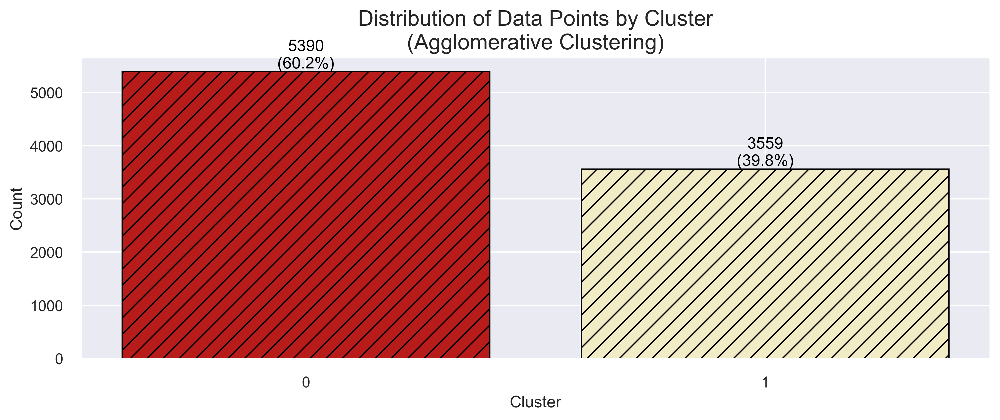

In [86]:
# Distribution of Data Points by Cluster
counts = Agglomerative_clustered_df['Agglomerative Cluster'].value_counts()
labels = counts.index.tolist()
sizes = counts.tolist()

# Calculate percentages and counts
total = sum(sizes)
percentages = [(size / total) * 100 for size in sizes]
counts = [f'{size}\n({percentages[i]:.1f}%)' for i, size in enumerate(sizes)]

# Create the bar plot
plt.figure(figsize=(12, 4))
colors = ["#B71C1B","#F2ECC6"]
sns.set_style('darkgrid')
bars = plt.bar(labels, sizes, color=colors, edgecolor='black', linewidth=1, hatch='//')
plt.xticks(range(len(labels)), [str(i) for i in range(len(labels))])

# Add counts to bars
for i, bar in enumerate(bars):
    plt.text(bar.get_x() + bar.get_width() / 2, bar.get_height() + 1,
             counts[i], ha='center', va='bottom', color='black', fontsize=12)

# Set the axis labels and title
plt.xlabel('Cluster', fontsize= 12)
plt.ylabel('Count', fontsize= 12)
plt.title('Distribution of Data Points by Cluster\n(Agglomerative Clustering)', fontsize= 16)
plt.show()

#### 🌴Distribution of data in different clusters

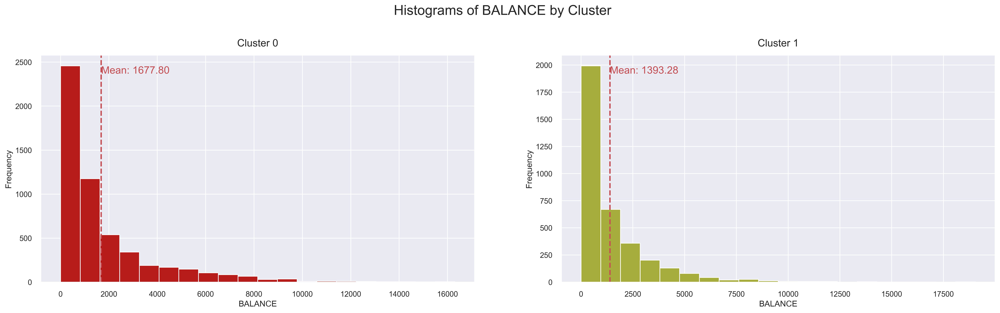

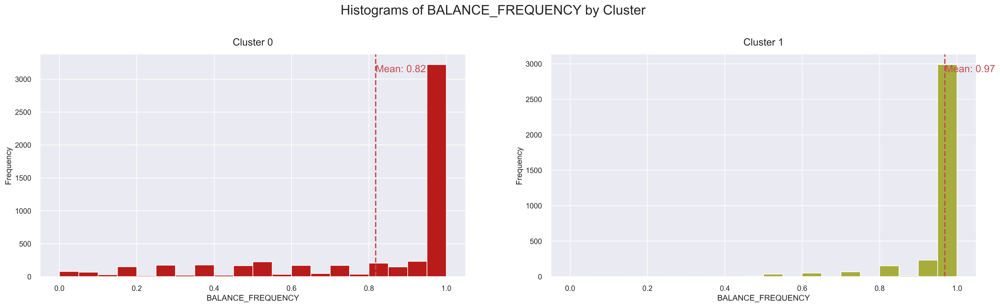

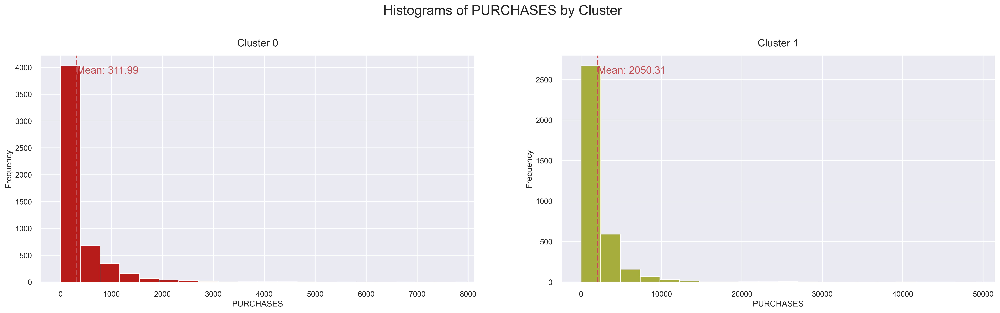

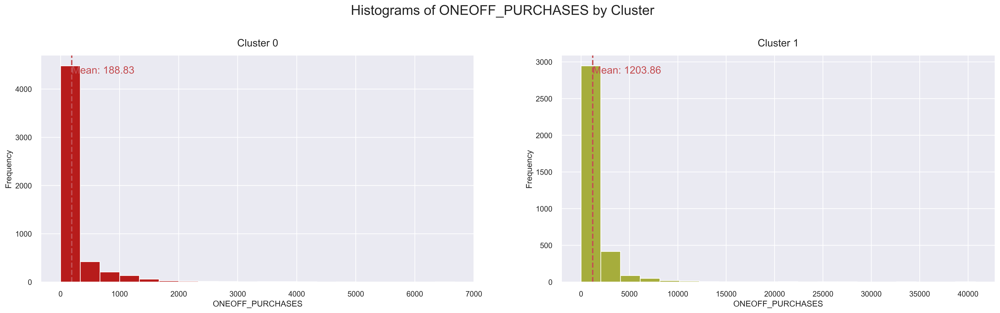

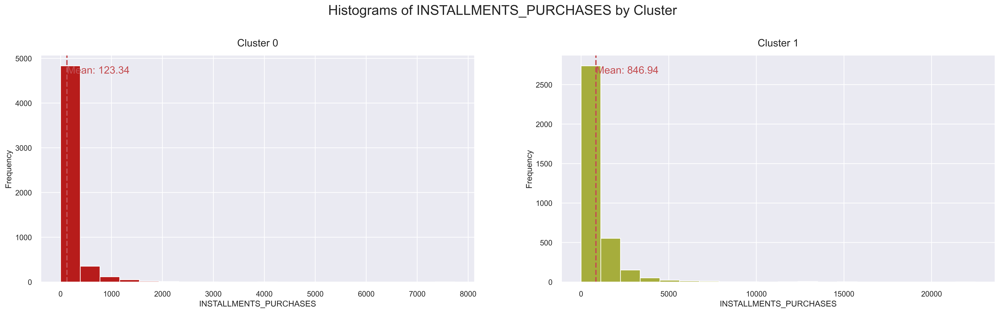

...

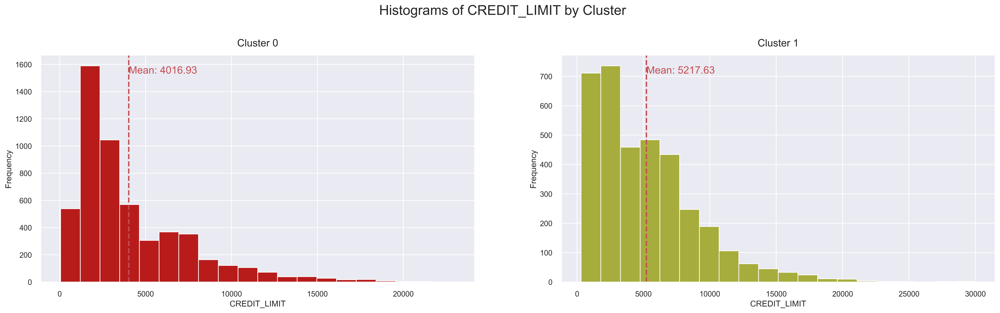

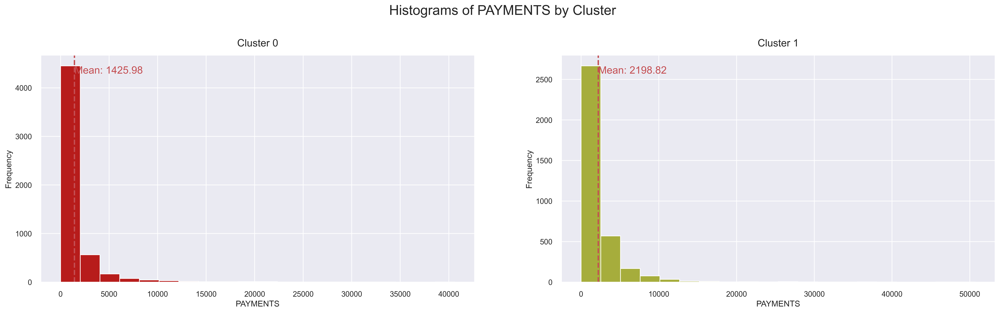

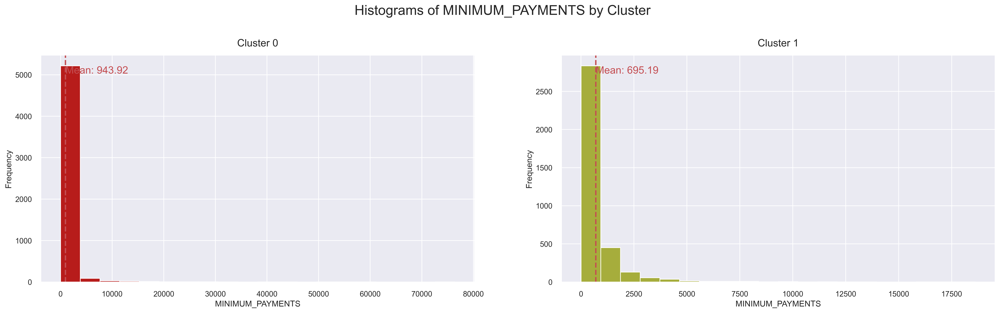

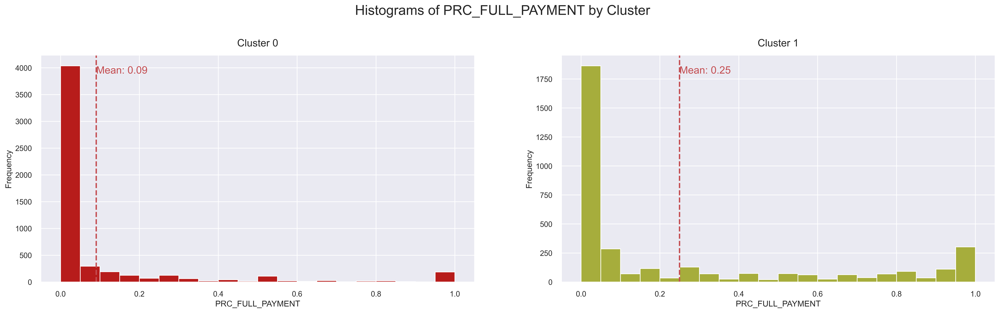

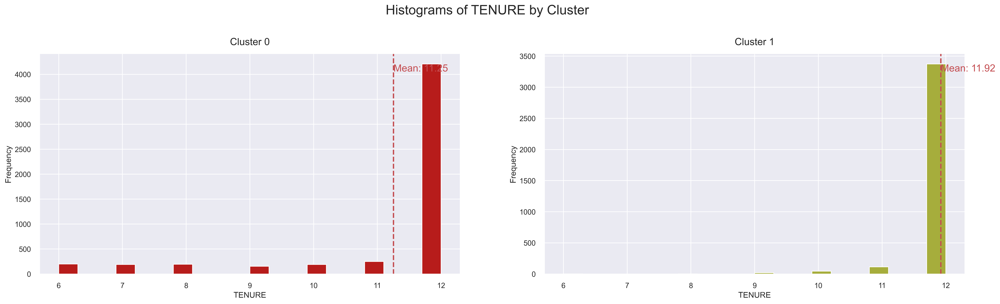

In [87]:
# Define custom color palette
colors = ["#B71C1B", "#A6AD3C"]

# Plot the histogram of various clusters
for col in df.columns:
    # Create a figure with subplots for each cluster
    fig, axes = plt.subplots(1, 2, figsize=(25,6))
    # Set the figure title
    fig.suptitle(f'Histograms of {col} by Cluster', fontsize=20, y=1.05)
    for j in range(2):
        # Select data for the current cluster and column
        cluster = Agglomerative_clustered_df[Agglomerative_clustered_df['Agglomerative Cluster'] == j][col]
        # Plot the histogram for the current cluster and column
        counts, bins, patches = axes[j].hist(cluster, bins=20, color=colors[j])
        # Calculate and add the mean line to the histogram
        mean = cluster.mean()
        axes[j].axvline(mean, color='r', linestyle='dashed', linewidth=2)
        ymin, ymax = axes[j].get_ylim()
        axes[j].text(mean, ymax*0.95, f"Mean: {mean:.2f}", ha='left', va='top', color='r', fontsize=15)
        # Set the subplot title and axis labels
        axes[j].set_title(f'Cluster {j}', fontsize=15, y=1.02)
        axes[j].set_xlabel(col, fontsize=12)
        axes[j].set_ylabel('Frequency', fontsize=12)
    # Adjust the spacing between subplots and display the plot
    plt.subplots_adjust(wspace=0.2)
    plt.show()

#### 🌴Cluster Analysis and customers segmentation (Scaled data)

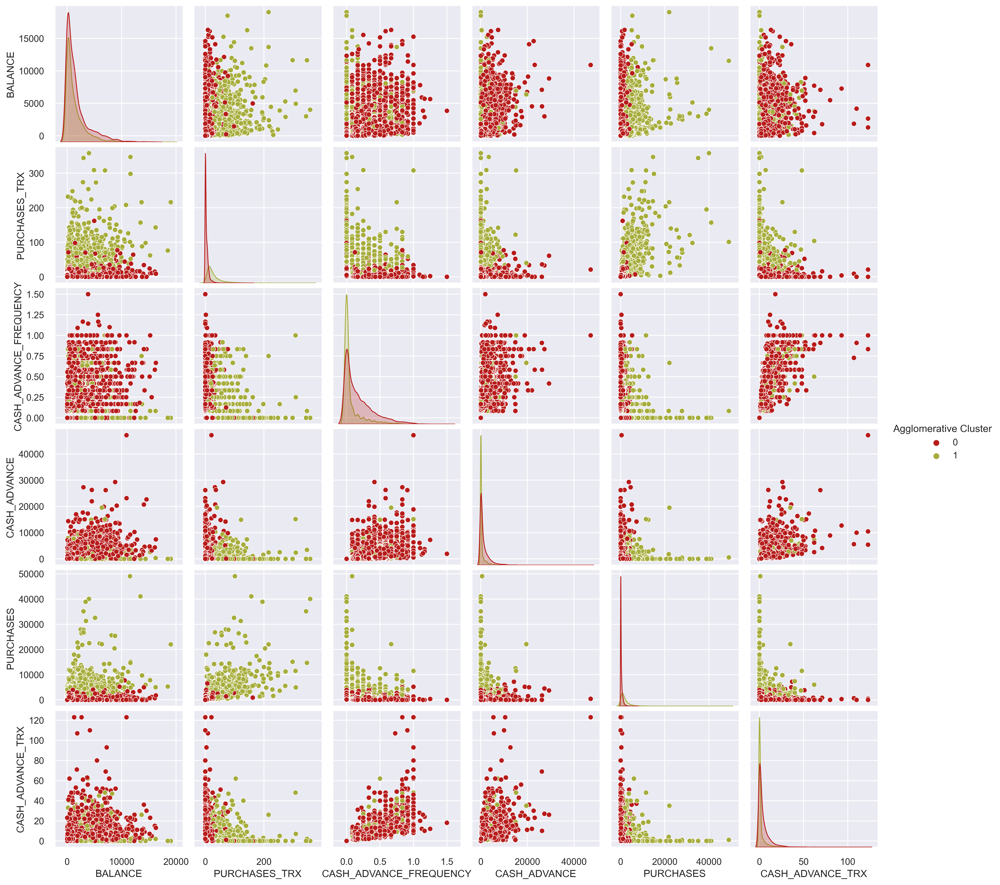

In [88]:
# Pairplot (Scaled data)
colors = ["#B71C1B","#A6AD3C"]

important_variables = ['BALANCE', 'PURCHASES_TRX', 'CASH_ADVANCE_FREQUENCY', 'CASH_ADVANCE', 'PURCHASES', 'CASH_ADVANCE_TRX', 'Agglomerative Cluster']

sns.set_style('darkgrid')
sns.pairplot(Agglomerative_clustered_df[important_variables], hue='Agglomerative Cluster', palette=colors)
plt.show()

In [89]:
# Summarizing the average values of each feature within each cluster
avg_df = Agglomerative_clustered_df.groupby(['Agglomerative Cluster'], as_index=False).mean()
avg_df.style.background_gradient(cmap=cmap).set_properties(**{'font-family': 'Segoe UI'}).hide_index()

Agglomerative Cluster,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,1677.802056,0.817193,311.990677,188.828234,123.337787,1355.782900,0.243242,0.080932,0.163115,0.181109,4.347495,4.348980,4016.932610,1425.981436,943.924698,0.090453,11.252505
1,1393.278512,0.968457,2050.310062,1203.857907,846.941486,408.271923,0.864727,0.386562,0.669436,0.065523,1.585558,30.405170,5217.634550,2198.816661,695.189921,0.249566,11.919921


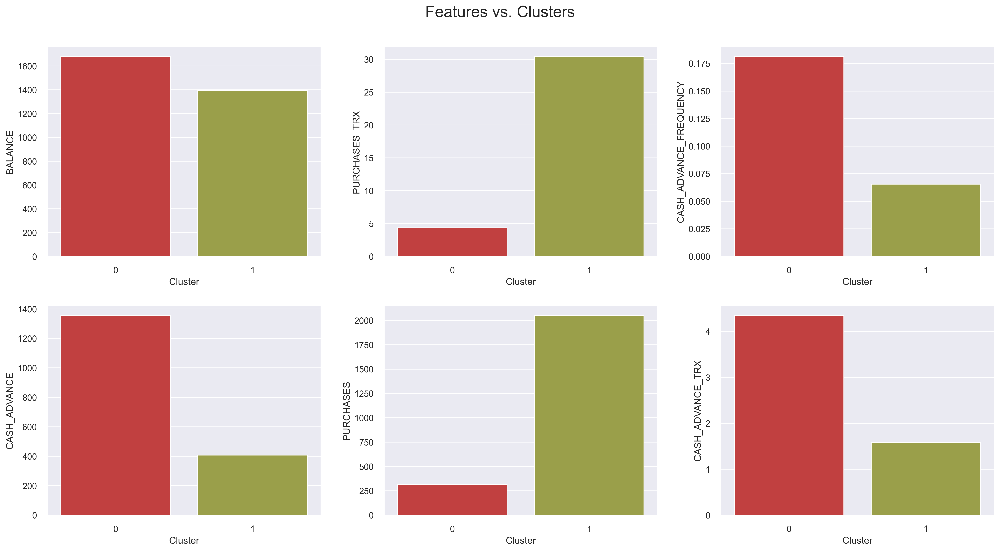

In [90]:
custom_colors = ["#D72A2B","#A6AD3C"]

fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(18, 10))
for i, col in enumerate(['BALANCE', 'PURCHASES_TRX', 'CASH_ADVANCE_FREQUENCY', 'CASH_ADVANCE', 'PURCHASES', 'CASH_ADVANCE_TRX']):
    sns.barplot(x='Agglomerative Cluster', y=col, data=avg_df, ax=axes[i//3][i%3], palette=custom_colors)
    axes[i//3][i%3].set_xlabel('Cluster')
    axes[i//3][i%3].set_ylabel(col)
plt.suptitle('Features vs. Clusters', fontsize=20)
fig.tight_layout(pad=2.0)
plt.show()

In [91]:
db_g = pd.DataFrame(Agglomerative_clustered_df.groupby(['Agglomerative Cluster','TENURE'])['TENURE'].count())
db_g.T.style.background_gradient(cmap=cmap).set_properties(**{'font-family': 'Segoe UI'})

#### 🌴Distribution of the most important features after Clustering

In [92]:
colors_mix = ["#F2ECC6","#D5D68A","#A6AD3C","#798517", "#D5D68A","#A6AD3C","#798517", "#B71C1B", "#D72A2B"]
colors_dark = ["#D72A2B","#F2ECC6","#D5D68A","#A6AD3C","#798517", "#D5D68A","#A6AD3C","#798517", "#B71C1B"]

features = ['BALANCE', 'PURCHASES_TRX', 'CASH_ADVANCE_FREQUENCY', 'CASH_ADVANCE', 'PURCHASES', 'CASH_ADVANCE_TRX']

for feature in features:
    fig = px.histogram(Agglomerative_clustered_df, x=feature, color='Agglomerative Cluster', template=temp,
                       marginal='box', opacity=0.7, nbins=50, color_discrete_sequence=[colors_mix[2],colors_mix[7]],
                       barmode='group', histfunc='count')
    
    fig.update_layout(
        font_family='monospace',
        title=dict(text=f'Distribution of {feature} After Clustering', x=0.5, y=0.95,
                   font=dict(color=colors_dark[2], size=20)),
        xaxis_title_text=feature,
        yaxis_title_text='Count',
        legend=dict(x=1, y=0.96, bordercolor=colors_dark[4], borderwidth=0, tracegroupgap=5),
        bargap=0.3,
    )
    fig.show()

#### 🌴Cluster Analysis and customers segmentation (Orginal data)

In [93]:
# Create an instance of the AgglomerativeClustering class with the specified parameters
hc = AgglomerativeClustering(n_clusters=2, affinity='euclidean', linkage='ward', compute_full_tree=False)

# Fit the clustering model to the data and predict the cluster labels for each observation
pred = hc.fit_predict(df)

# Create a copy of the original DataFrame to avoid modifying it directly
df_hc = df.copy()

# Add a new column to the DataFrame with the predicted cluster labels
df_hc["Agglomerative Cluster"] = pred

# Sort the DataFrame by the cluster labels to group similar observations together
df_hc = df_hc.sort_values(by='Agglomerative Cluster')

# Convert the cluster labels to categorical variables for easier analysis
df_hc['Agglomerative Cluster'] = df_hc['Agglomerative Cluster'].astype('category')

In [94]:
df_hc.head(10).style.set_properties(**{'background-color': '#F2ECC6'}, subset=['Agglomerative Cluster'])

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,Agglomerative Cluster
4474,5256.695330,1.000000,188.600000,188.600000,0.000000,1934.418697,0.083333,0.083333,0.000000,0.333333,4,1,9000.000000,1421.954639,1452.249653,0.000000,12,0
1631,3515.039029,1.000000,2924.080000,1385.290000,1538.790000,7867.732492,1.000000,0.333333,1.000000,0.750000,31,85,4000.000000,10693.278430,1886.056721,0.000000,12,0
1629,7339.943073,0.875000,0.000000,0.000000,0.000000,9123.485636,0.000000,0.000000,0.000000,0.375000,11,0,9000.000000,1314.192386,2062.636412,0.000000,8,0
1628,283.300160,1.000000,461.360000,0.000000,461.360000,0.000000,0.666667,0.000000,0.666667,0.000000,0,9,9000.000000,526.087388,177.721392,0.000000,12,0
3883,4285.123888,1.000000,4235.030000,4235.030000,0.000000,0.000000,0.833333,0.833333,0.000000,0.000000,0,29,10000.000000,1660.328580,1243.967283,0.000000,12,0
7763,10856.483010,1.000000,45.650000,45.650000,0.000000,5096.886673,0.083333,0.083333,0.000000,0.250000,5,1,14500.000000,2670.733732,2917.469357,0.000000,12,0
1624,8159.168439,1.000000,2453.070000,1845.550000,607.520000,3278.461198,1.000000,0.916667,1.000000,0.250000,3,42,15000.000000,1698.958527,2137.893656,0.000000,12,0
1621,41.762859,0.090909,0.000000,0.000000,0.000000,1125.868686,0.000000,0.000000,0.000000,0.083333,3,0,12000.000000,0.000000,312.452292,0.000000,12,0
1619,25.414572,1.000000,262.920000,262.920000,0.000000,0.000000,0.916667,0.916667,0.000000,0.000000,0,11,13000.000000,280.367131,170.017741,0.636364,12,0
1618,7611.152584,1.000000,3707.790000,3707.790000,0.000000,0.000000,0.666667,0.666667,0.000000,0.000000,0,57,12000.000000,4610.460803,4441.612219,0.000000,12,0


In [95]:
df_hc.shape

(8949, 18)

#### 🌴Distribution of Data Points by Cluster

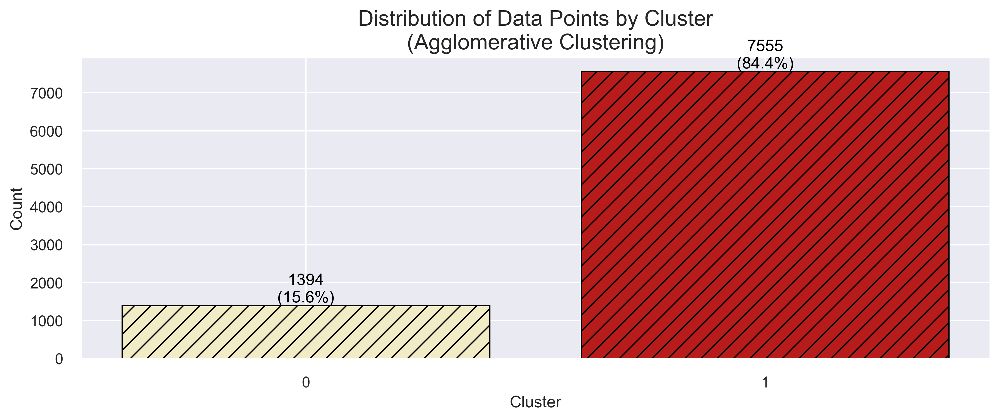

In [96]:
# Distribution of Data Points by Cluster
counts = df_hc['Agglomerative Cluster'].value_counts()
labels = counts.index.tolist()
sizes = counts.tolist()

# Calculate percentages and counts
total = sum(sizes)
percentages = [(size / total) * 100 for size in sizes]
counts = [f'{size}\n({percentages[i]:.1f}%)' for i, size in enumerate(sizes)]

# Create the bar plot
plt.figure(figsize=(12, 4))
colors = ["#B71C1B","#F2ECC6"]
bars = plt.bar(labels, sizes, color=colors, edgecolor='black', linewidth=1, hatch='//')
plt.xticks(range(len(labels)), [str(i) for i in range(len(labels))])

# Add counts to bars
for i, bar in enumerate(bars):
    plt.text(bar.get_x() + bar.get_width() / 2, bar.get_height() + 1,
             counts[i], ha='center', va='bottom', color='black', fontsize=12)

# Set the axis labels and title
plt.xlabel('Cluster', fontsize= 12)
plt.ylabel('Count', fontsize= 12)
plt.title('Distribution of Data Points by Cluster\n(Agglomerative Clustering)', fontsize= 16)
plt.show()

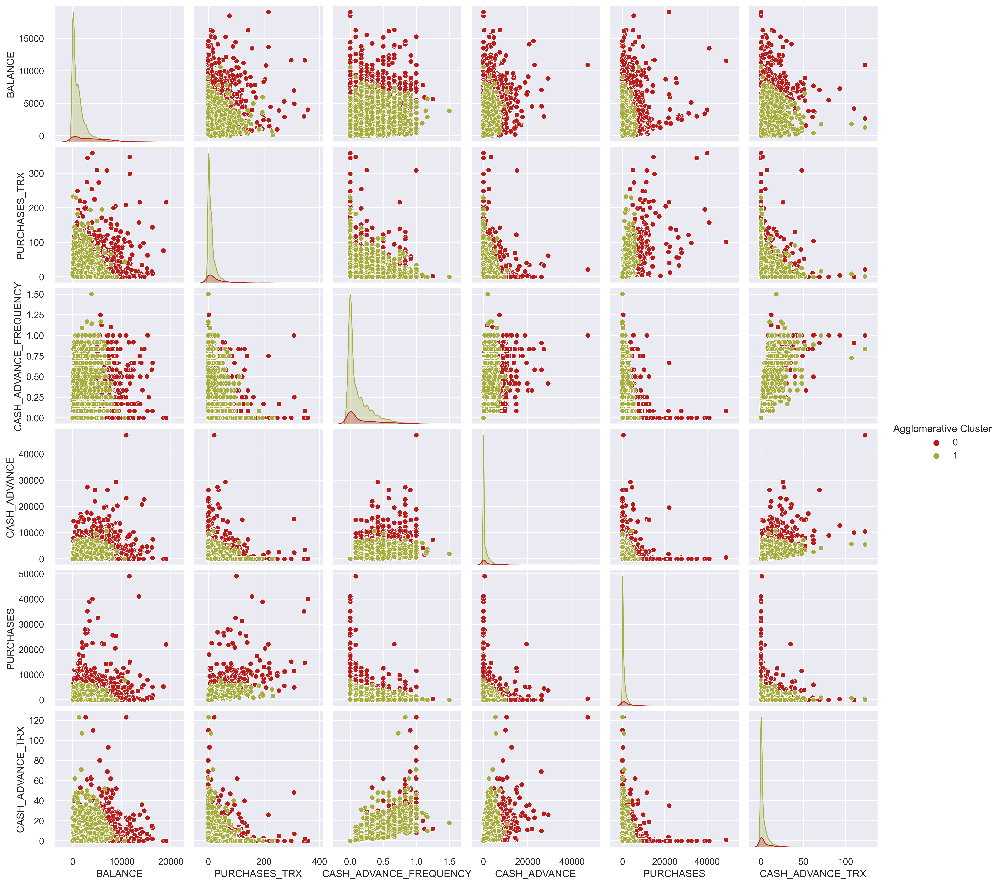

In [97]:
# Pairplot (Orginal data)
colors = ["#B71C1B","#A6AD3C"]

sns.set_style('darkgrid')
sns.pairplot(df_hc[important_variables], hue='Agglomerative Cluster', palette=colors)
plt.show()

In [98]:
# Plot of clusters
fig = px.scatter(df_hc, x="PURCHASES", y="CASH_ADVANCE_TRX", color="Agglomerative Cluster", 
                 color_discrete_sequence=px.colors.qualitative.Prism)
fig.update_traces(marker=dict(size=11, opacity=0.75, line=dict(width=1, color='#F7F7F7')))
fig.update_layout(template=temp, title="Agglomerative Cluster Profiles,<br>PURCHASES vs. CASH_ADVANCE_TRX", 
                  width=700, legend_title='Agglomerative Cluster',
                  xaxis=dict(title='PURCHASES', showline=True, zeroline=False), 
                  yaxis=dict(title='CASH_ADVANCE_TRX', ticksuffix='k', showline=True))
fig.show()